In [ ]:
'''
!unzip '/content/drive/MyDrive/Sem-2/DL/Project - Person Detection/Heridal/heridal.zip' -d '/content/drive/MyDrive/Sem-2/DL/Project - Person Detection/Heridal/Unzipped'
'''

"\n!unzip '/content/drive/MyDrive/Sem-2/DL/Project - Person Detection/Heridal/heridal.zip' -d '/content/drive/MyDrive/Sem-2/DL/Project - Person Detection/Heridal/Unzipped'\n"

In [ ]:
from osgeo import gdal
import glob
import cv2
import os
from tqdm import tqdm_notebook
from google.colab.patches import cv2_imshow
from sklearn.model_selection import train_test_split
import numpy as np
from keras.utils.conv_utils import normalize_data_format

In [ ]:
pos_folder = '/content/drive/MyDrive/Sem-2/DL/Project - Person Detection/Heridal/heridal/patches/positive'
neg_folder = '/content/drive/MyDrive/Sem-2/DL/Project - Person Detection/Heridal/heridal/patches/negative'

# Loading all the file names into a dictionary. 
 
Loading all the file names into a string format reduces the loading time

In [ ]:
temp_dict = {}
temp_dict['Negative'] = []
for filename in tqdm_notebook(glob.iglob(neg_folder + '**/*.jpg', recursive=True)):
  temp_dict['Negative'].append(filename)
  #print(filename)

temp_dict['Positive'] = []
for filename in tqdm_notebook(glob.iglob(pos_folder + '**/*.jpg', recursive=True)):
  temp_dict['Positive'].append(filename)
  #print(filename)

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:3: TqdmDeprecationWarning: This function will be removed in tqdm==5.0.0
Please use `tqdm.notebook.tqdm` instead of `tqdm.tqdm_notebook`
  This is separate from the ipykernel package so we can avoid doing imports until


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:8: TqdmDeprecationWarning: This function will be removed in tqdm==5.0.0
Please use `tqdm.notebook.tqdm` instead of `tqdm.tqdm_notebook`
  


In [ ]:
temp_dict['Negative'] = []
for filename in tqdm_notebook(glob.iglob(neg_folder + '**/*.jpg', recursive=True)):
  temp_dict['Negative'].append(filename)
  #print(filename)

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:2: TqdmDeprecationWarning: This function will be removed in tqdm==5.0.0
Please use `tqdm.notebook.tqdm` instead of `tqdm.tqdm_notebook`
  


In [ ]:
print(len(temp_dict['Positive']))
print(len(temp_dict['Negative']))

18255
39052


Loading the images as batches

In [ ]:
import cv2
images_dict = {}
images_dict['Positive'] = []
images_dict['Negative'] = []
#pos_images = []
#neg_images = []

def runbatch(temp_dict,flag,s,e):
  global images_dict
  for i in tqdm_notebook(range(s,e)):
    name = temp_dict[str(flag)][i]
    #pos_images[name] =
    img = cv2.imread(name)
    if img is not None:
      images_dict[str(flag)].append(img)
      #pos_images.append(img)
  print(s,e,"Returning")
  #return images

Running each batch on different threads to reduce loading time

In [ ]:
import threading
#tr = []
#previous = 0

'''
t1 = threading.Thread(target=runbatch, args=(temp_dict,'Negative',0,1000))
t2 = threading.Thread(target=runbatch, args=(temp_dict,'Negative',1000,2000))
t1.start()
t2.start()

temp1 = t1.join()
temp2 = t2.join()
'''

def threading_call(temp_dict,flag_name,start,end,batch_size):
  tr =[]
  #previous = start
  for i in range(start,end,batch_size):
    #print(i,i+batch_size,end=" ")
    #previous = i
    
    tr.append(threading.Thread(target=runbatch, args=(temp_dict,str(flag_name),i,i+batch_size)))
    #previous = i

  for i in range(len(tr)):
    tr[i].start()


  for i in tqdm_notebook(range(len(tr))):
    tr[i].join()
    



In [ ]:
import time
images_dict['Negative'] = []
start_time = time.time()
threading_call(temp_dict,'Negative',0,10000,1000)
threading_call(temp_dict,'Negative',10000,20000,1000)
threading_call(temp_dict,'Negative',20000,30000,1000)
threading_call(temp_dict,'Negative',30000,39000,1000)
threading_call(temp_dict,'Negative',39000,len(temp_dict['Negative']),4)

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:10: TqdmDeprecationWarning: This function will be removed in tqdm==5.0.0
Please use `tqdm.notebook.tqdm` instead of `tqdm.tqdm_notebook`
  # Remove the CWD from sys.path while we load stuff.


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:29: TqdmDeprecationWarning: This function will be removed in tqdm==5.0.0
Please use `tqdm.notebook.tqdm` instead of `tqdm.tqdm_notebook`



8000 9000 Returning

0 1000 Returning


3000 4000 Returning
1000 2000 Returning

4000 5000 Returning

5000 6000 Returning

9000 10000 Returning

7000 8000 Returning

6000 7000 Returning

2000 3000 Returning




13000 14000 Returning

10000 11000 Returning

14000 15000 Returning

11000 12000 Returning

12000 13000 Returning

16000 17000 Returning

18000 19000 Returning

15000 16000 Returning

19000 20000 Returning

17000 18000 Returning




22000 23000 Returning

27000 28000 Returning

25000 26000 Returning

20000 21000 Returning

23000 24000 Returning

26000 27000 Returning

28000 29000 Returning

21000 22000 Returning

24000 25000 Returning

29000 30000 Returning




31000 32000 Returning

32000 33000 Returning

36000 37000 Returning

33000 34000 Returning

37000 38000 Returning

30000 31000 Returning

35000 36000 Returning

34000 35000 Returning

38000 39000 Returning




39004 39008 Returning

39008 39012 Returning

39016 39020 Returning

39000 39004 Returning


39040 39044 Returning
39036 39040 Returning



39024 39028 Returning


39028 39032 
39048 39052 Returning
39032Returning
39012 39016 Returning
39020 39036 Returning

39044 39048 Returning
 39024 Returning



In [ ]:
print("--- %s seconds ---" % (time.time() - start_time))
print(len(images_dict['Negative']))

--- 118.05263066291809 seconds ---
39052


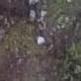

In [ ]:
cv2_imshow(images_dict['Negative'][-2])

In [ ]:
images_dict['Positive'] = []
start_time = time.time()
threading_call(temp_dict,'Positive',0,10000,1000)
threading_call(temp_dict,'Positive',10000,18000,1000)
threading_call(temp_dict,'Positive',18000,18250,250)
threading_call(temp_dict,'Positive',18250,len(temp_dict['Positive']),5)

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:10: TqdmDeprecationWarning: This function will be removed in tqdm==5.0.0
Please use `tqdm.notebook.tqdm` instead of `tqdm.tqdm_notebook`
  # Remove the CWD from sys.path while we load stuff.


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:29: TqdmDeprecationWarning: This function will be removed in tqdm==5.0.0
Please use `tqdm.notebook.tqdm` instead of `tqdm.tqdm_notebook`



1000 2000 Returning

8000 9000 Returning

3000 4000 Returning

5000 6000 Returning

7000 8000 Returning

2000 3000 Returning

4000 5000 Returning

0 1000 Returning

9000 10000 Returning

6000 7000 Returning




11000 12000 Returning

12000 13000 Returning

10000 11000 Returning

14000 15000 Returning

15000 16000 Returning

13000 14000 Returning

16000 17000 Returning

17000 18000 Returning




18000 18250 Returning




18250 18255 Returning



In [ ]:
print("--- %s seconds ---" % (time.time() - start_time))
print(len(images_dict['Positive']))

--- 64.11444520950317 seconds ---
18255


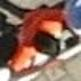

In [ ]:
cv2_imshow(images_dict['Positive'][-200])

In [ ]:
type(images_dict['Positive'][-3])

numpy.ndarray

In [ ]:
#Merging everything into 1 dataset
dataset = []
labels = []
for i in tqdm_notebook(range(len(images_dict['Positive']))):
  dataset.append(images_dict['Positive'][i])
  labels.append(1)  

for i in tqdm_notebook(range(len(images_dict['Negative']))):
  dataset.append(images_dict['Negative'][i])
  labels.append(0)

dataset = np.array(dataset)
labels = np.array(labels)


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:4: TqdmDeprecationWarning: This function will be removed in tqdm==5.0.0
Please use `tqdm.notebook.tqdm` instead of `tqdm.tqdm_notebook`
  after removing the cwd from sys.path.


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:8: TqdmDeprecationWarning: This function will be removed in tqdm==5.0.0
Please use `tqdm.notebook.tqdm` instead of `tqdm.tqdm_notebook`
  


In [ ]:
X_train, X_test, Y_train, Y_test = train_test_split(dataset, labels, test_size = 0.20, random_state = 0) #Splitting the full dataset into train and test

In [ ]:
print("Training Size = ",X_train.shape)
#print("Val Size = ",X_val.shape)
print("Testing Size = ",X_test.shape)

Training Size =  (45845, 81, 81, 3)
Testing Size =  (11462, 81, 81, 3)


In [ ]:
X_train, X_val, Y_train, Y_val  = train_test_split(X_train, Y_train, test_size=0.25, random_state=1) # 0.25 x 0.8 = 0.2

In [ ]:
print("Training Size = ",X_train.shape)
print("Val Size = ",X_val.shape)
print("Testing Size = ",X_test.shape)

Training Size =  (34383, 81, 81, 3)
Val Size =  (11462, 81, 81, 3)
Testing Size =  (11462, 81, 81, 3)


In [ ]:
SIZE = 81
INPUT_SHAPE = (SIZE, SIZE, 3)

In [ ]:
from numpy import save
from numpy import load

save('/content/drive/MyDrive/Sem-2/CV/Project/X_train.npy', X_train)
save('/content/drive/MyDrive/Sem-2/CV/Project/X_val.npy', X_val)
save('/content/drive/MyDrive/Sem-2/CV/Project/X_test.npy', X_test)

save('/content/drive/MyDrive/Sem-2/CV/Project/Y_train.npy', Y_train)
save('/content/drive/MyDrive/Sem-2/CV/Project/Y_val.npy', Y_val)
save('/content/drive/MyDrive/Sem-2/CV/Project/Y_test.npy', Y_test)


X_val_2 = load('/content/drive/MyDrive/Sem-2/CV/Project/X_val.npy')
X_test_2 = load('/content/drive/MyDrive/Sem-2/CV/Project/X_test.npy')
X_train_2 = load('/content/drive/MyDrive/Sem-2/CV/Project/X_train.npy')


In [ ]:
print("Training Size = ",X_train_2.shape)
print("Val Size = ",X_val_2.shape)
print("Testing Size = ",X_test_2.shape)

Training Size =  (34383, 81, 81, 3)
Val Size =  (11462, 81, 81, 3)
Testing Size =  (11462, 81, 81, 3)


Loading entire data

In [ ]:
from numpy import load
import matplotlib.pyplot as plt


X_val = load('/content/drive/MyDrive/Sem-2/CV/Project/X_val.npy')
X_test = load('/content/drive/MyDrive/Sem-2/CV/Project/X_test.npy')
X_train = load('/content/drive/MyDrive/Sem-2/CV/Project/X_train.npy')

print("Training Size = ",X_train.shape)
print("Val Size = ",X_val.shape)
print("Testing Size = ",X_test.shape)
X_val_2 = load('/content/drive/MyDrive/Sem-2/CV/Project/X_val.npy')
X_test_2 = load('/content/drive/MyDrive/Sem-2/CV/Project/X_test.npy')
X_train_2 = load('/content/drive/MyDrive/Sem-2/CV/Project/X_train.npy')

Y_val_2 = load('/content/drive/MyDrive/Sem-2/CV/Project/Y_val.npy')
Y_test_2 = load('/content/drive/MyDrive/Sem-2/CV/Project/Y_test.npy')
Y_train_2 = load('/content/drive/MyDrive/Sem-2/CV/Project/Y_train.npy')



Y_val = load('/content/drive/MyDrive/Sem-2/CV/Project/Y_val.npy')
Y_test = load('/content/drive/MyDrive/Sem-2/CV/Project/Y_test.npy')
Y_train = load('/content/drive/MyDrive/Sem-2/CV/Project/Y_train.npy')


print("Y - Training Size = ",Y_train.shape)
print("Y - Val Size = ",Y_val.shape)
print("Y - Testing Size = ",Y_test.shape)

Training Size =  (34383, 81, 81, 3)
Val Size =  (11462, 81, 81, 3)
Testing Size =  (11462, 81, 81, 3)
Y - Training Size =  (34383,)
Y - Val Size =  (11462,)
Y - Testing Size =  (11462,)


Plotting Training Images

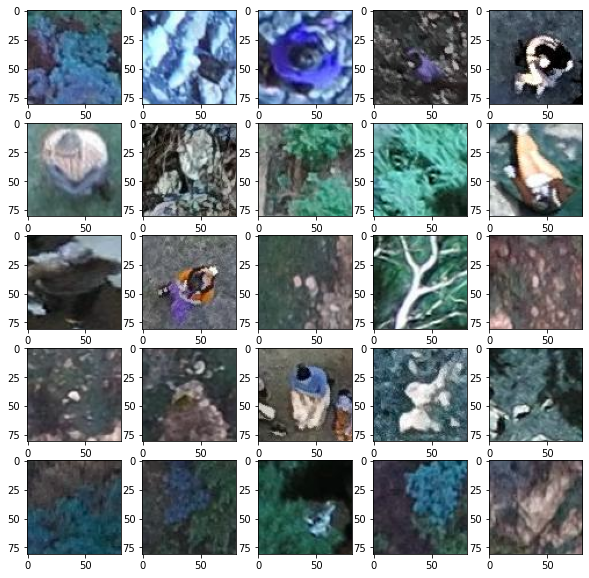

In [ ]:
import matplotlib.pyplot as plt

plt.figure(figsize=(10,10)) # specifying the overall grid size

for i in range(25):
    plt.subplot(5,5,i+1)    # the number of images in the grid is 5*5 (25)
    plt.imshow(X_train[i])

plt.show()

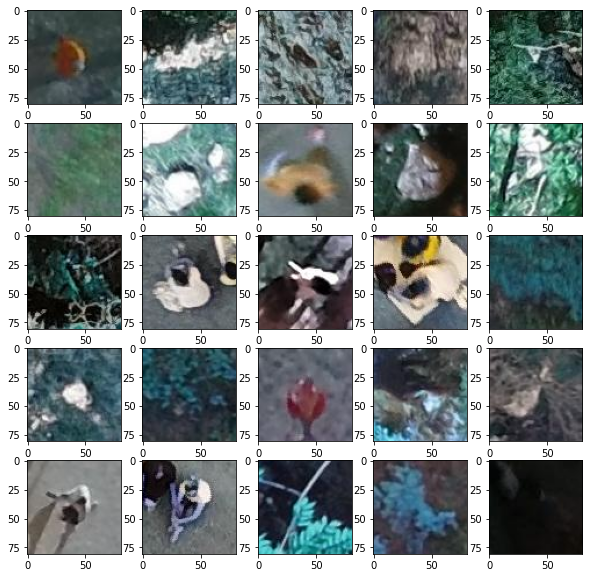

In [ ]:
plt.figure(figsize=(10,10)) # specifying the overall grid size

for i in range(25):
    plt.subplot(5,5,i+1)    # the number of images in the grid is 5*5 (25)
    plt.imshow(X_val[i])

plt.show()

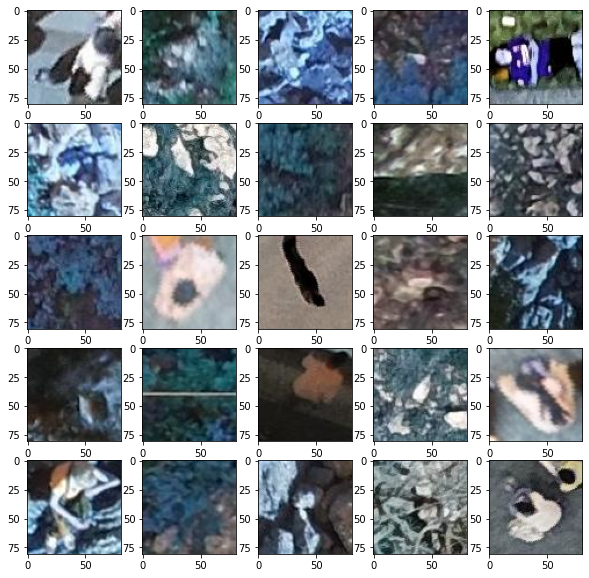

In [ ]:
plt.figure(figsize=(10,10)) # specifying the overall grid size

for i in range(25):
    plt.subplot(5,5,i+1)    # the number of images in the grid is 5*5 (25)
    plt.imshow(X_test[i])

plt.show()

In [ ]:
from keras.models import Sequential
from keras.layers import Conv2D, MaxPooling2D, BatchNormalization
from keras.layers import Activation, Dropout, Flatten, Dense

import matplotlib.pyplot as plt
import matplotlib.image as mpimg
import keras

In [ ]:
#Getting 92% validation accuracy with this model - 10 epochs
''' 
model = Sequential()
model.add(Conv2D(32, (3, 3), input_shape=INPUT_SHAPE))
model.add(Activation('relu'))
model.add(MaxPooling2D(pool_size=(2, 2)))

model.add(Conv2D(32, (3, 3), kernel_initializer = 'he_uniform'))
model.add(Activation('relu'))
model.add(MaxPooling2D(pool_size=(2, 2)))

model.add(Conv2D(64, (3, 3), kernel_initializer = 'he_uniform'))
model.add(Activation('relu'))
model.add(MaxPooling2D(pool_size=(2, 2)))

model.add(Flatten())
model.add(Dense(64))
model.add(Activation('relu'))
model.add(Dropout(0.5))

model.add(Dense(1))
model.add(Activation('sigmoid'))
'''


In [ ]:
'''
model = Sequential()
model.add(Conv2D(32, (3, 3), input_shape=INPUT_SHAPE))
model.add(Activation('relu'))
model.add(MaxPooling2D(pool_size=(3, 3),strides=3))

model.add(Conv2D(32, (3, 3), kernel_initializer = 'he_uniform'))
model.add(Activation('relu'))
model.add(MaxPooling2D(pool_size=(3, 3),strides=3))

model.add(Conv2D(64, (3, 3), kernel_initializer = 'he_uniform'))
model.add(Activation('relu'))
#model.add(MaxPooling2D(pool_size=(2, 2)))

model.add(Conv2D(64, (3, 3), kernel_initializer = 'he_uniform'))
model.add(Activation('relu'))
#model.add(MaxPooling2D(pool_size=(2, 2)))


model.add(Flatten())
model.add(Dense(64))
model.add(Activation('relu'))
model.add(Dropout(0.5))

model.add(Dense(1))
model.add(Activation('sigmoid'))
'''

In [ ]:
model = Sequential()
model.add(Conv2D(64, (3, 3), input_shape=INPUT_SHAPE))
model.add(Activation('relu'))
model.add(MaxPooling2D(pool_size=(3, 3),strides=3))

model.add(Conv2D(64, (3, 3), kernel_initializer = 'he_uniform'))
model.add(Activation('relu'))
model.add(MaxPooling2D(pool_size=(3, 3),strides=3))

model.add(Conv2D(128, (3, 3), kernel_initializer = 'he_uniform'))
model.add(Activation('relu'))
#model.add(MaxPooling2D(pool_size=(2, 2)))

model.add(Conv2D(128, (3, 3), kernel_initializer = 'he_uniform'))
model.add(Activation('relu'))
#model.add(MaxPooling2D(pool_size=(2, 2)))


model.add(Flatten())
model.add(Dense(128))
model.add(Activation('relu'))
model.add(Dropout(0.5))

model.add(Dense(1))
model.add(Activation('sigmoid'))


In [ ]:
'''
lr_schedule = keras.optimizers.schedules.ExponentialDecay(
    initial_learning_rate=1e-2,
    decay_steps=10000,
    decay_rate=0.9)
opt = keras.optimizers.SGD(learning_rate=lr_schedule)
'''

model.compile(loss='binary_crossentropy',
              optimizer='Adam',             
              metrics=['accuracy'])

print(model.summary())   

Model: "sequential"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
conv2d (Conv2D)              (None, 79, 79, 64)        1792      
_________________________________________________________________
activation (Activation)      (None, 79, 79, 64)        0         
_________________________________________________________________
max_pooling2d (MaxPooling2D) (None, 26, 26, 64)        0         
_________________________________________________________________
conv2d_1 (Conv2D)            (None, 24, 24, 64)        36928     
_________________________________________________________________
activation_1 (Activation)    (None, 24, 24, 64)        0         
_________________________________________________________________
max_pooling2d_1 (MaxPooling2 (None, 8, 8, 64)          0         
_________________________________________________________________
conv2d_2 (Conv2D)            (None, 6, 6, 128)         7

In [ ]:
history = model.fit(X_train, 
                         Y_train, 
                         batch_size = 32, 
                         verbose = 1, 
                         epochs = 20,      
                         validation_data=(X_val,Y_val),
                         shuffle = True
                     )

Epoch 1/20
1075/1075 [==============================] - 55s 11ms/step - loss: 1.5889 - accuracy: 0.8086 - val_loss: 0.2116 - val_accuracy: 0.9196
Epoch 2/20
1075/1075 [==============================] - 11s 10ms/step - loss: 0.2059 - accuracy: 0.9231 - val_loss: 0.1629 - val_accuracy: 0.9359
Epoch 3/20
1075/1075 [==============================] - 11s 10ms/step - loss: 0.1604 - accuracy: 0.9377 - val_loss: 0.1333 - val_accuracy: 0.9490
Epoch 4/20
1075/1075 [==============================] - 11s 10ms/step - loss: 0.1357 - accuracy: 0.9469 - val_loss: 0.1878 - val_accuracy: 0.9326
Epoch 5/20
1075/1075 [==============================] - 11s 10ms/step - loss: 0.1348 - accuracy: 0.9472 - val_loss: 0.1436 - val_accuracy: 0.9453
Epoch 6/20
1075/1075 [==============================] - 11s 10ms/step - loss: 0.1102 - accuracy: 0.9590 - val_loss: 0.1787 - val_accuracy: 0.9225
Epoch 7/20
1075/1075 [==============================] - 11s 10ms/step - loss: 0.1468 - accuracy: 0.9443 - val_loss: 0.1052 -

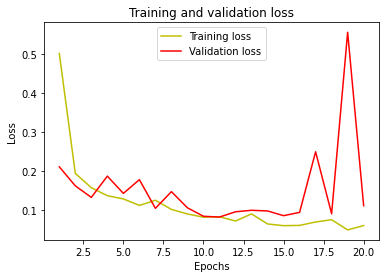

In [ ]:
loss = history.history['loss']
val_loss = history.history['val_loss']
epochs = range(1, len(loss) + 1)
plt.plot(epochs, loss, 'y', label='Training loss')
plt.plot(epochs, val_loss, 'r', label='Validation loss')
plt.title('Training and validation loss')
plt.xlabel('Epochs')
plt.ylabel('Loss')
plt.legend()
plt.show()


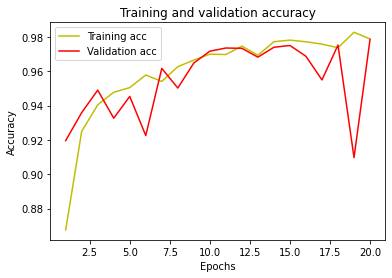

In [ ]:
acc = history.history['accuracy']
val_acc = history.history['val_accuracy']
plt.plot(epochs, acc, 'y', label='Training acc')
plt.plot(epochs, val_acc, 'r', label='Validation acc')
plt.title('Training and validation accuracy')
plt.xlabel('Epochs')
plt.ylabel('Accuracy')
plt.legend()
plt.show()

In [ ]:
_, acc = model.evaluate(X_test, Y_test)
print("Accuracy = ", (acc * 100.0), "%")

359/359 [==============================] - 1s 3ms/step - loss: 0.0817 - accuracy: 0.9787
Accuracy =  97.8712260723114 %


The prediction for this image is:  [[1.]]
The actual label for this image is:  1


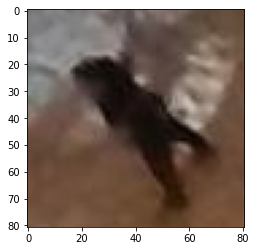

In [ ]:
img = X_test[100]
plt.imshow(img)
input_img = np.expand_dims(img, axis=0) #Expand dims so the input is (num images, x, y, c)
print("The prediction for this image is: ", model.predict(input_img))
print("The actual label for this image is: ", Y_test[100])

In [ ]:
model.save('/content/drive/MyDrive/Sem-2/CV/Project/Models/mymodel')

INFO:tensorflow:Assets written to: /content/drive/MyDrive/Sem-2/CV/Project/Models/mymodel/assets


In [ ]:
cd drive/MyDrive/Sem-2/CV/Project/Models/mymodel

/content/drive/MyDrive/Sem-2/CV/Project/Models/mymodel


In [ ]:
ls

assets/  keras_metadata.pb  saved_model.pb  variables/


In [ ]:
import tensorflow as tf
import os
new_model = tf.keras.models.load_model('/content/drive/MyDrive/Sem-2/CV/Project/Models/mymodel')


In [ ]:
new_model.summary()

Model: "sequential"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
conv2d (Conv2D)              (None, 79, 79, 64)        1792      
_________________________________________________________________
activation (Activation)      (None, 79, 79, 64)        0         
_________________________________________________________________
max_pooling2d (MaxPooling2D) (None, 26, 26, 64)        0         
_________________________________________________________________
conv2d_1 (Conv2D)            (None, 24, 24, 64)        36928     
_________________________________________________________________
activation_1 (Activation)    (None, 24, 24, 64)        0         
_________________________________________________________________
max_pooling2d_1 (MaxPooling2 (None, 8, 8, 64)          0         
_________________________________________________________________
conv2d_2 (Conv2D)            (None, 6, 6, 128)         7

In [ ]:
loss, acc = new_model.evaluate(X_test, Y_test, verbose=1)
print("Test Accuracy = ", (acc * 100.0), "%")

print(new_model.predict(X_test).shape)

359/359 [==============================] - 29s 79ms/step - loss: 0.0497 - accuracy: 0.9876
Test Accuracy =  98.76112341880798 %
(11462, 1)


In [ ]:
loss, acc = new_model.evaluate(X_train, Y_train, verbose=1)
print("Train Accuracy = ", (acc * 100.0), "%")

print(new_model.predict(X_train).shape)

1075/1075 [==============================] - 88s 82ms/step - loss: 0.0471 - accuracy: 0.9877
Train Accuracy =  98.7697422504425 %
(34383, 1)


In [ ]:
loss, acc = new_model.evaluate(X_val, Y_val, verbose=1)
print("Validation Accuracy = ", (acc * 100.0), "%")

print(new_model.predict(X_val).shape)

359/359 [==============================] - 28s 79ms/step - loss: 0.0483 - accuracy: 0.9887
Validation Accuracy =  98.86581897735596 %
(11462, 1)


In [ ]:
plt.plot(new_model.history.history['loss'])
plt.plot(new_model.history.history['val_loss'])
plt.title('model loss')
plt.ylabel('loss')
plt.xlabel('epoch')
plt.legend(['train', 'test'], loc='upper left')
plt.show()


plt.plot(new_model.history.history['acc'])
plt.plot(new_model.history.history['val_acc'])
plt.title('model Acc')
plt.ylabel('Accuracy')
plt.xlabel('epoch')
plt.legend(['train', 'test'], loc='upper left')
plt.show()


**Visualizing CNN**

In [ ]:
for layer in new_model.layers:
	# check for convolutional layer
	if 'conv' not in layer.name:
		continue
	# get filter weights
	filters, biases = layer.get_weights()
	print(layer.name, filters.shape)

conv2d (3, 3, 3, 64)
conv2d_1 (3, 3, 64, 64)
conv2d_2 (3, 3, 64, 128)
conv2d_3 (3, 3, 128, 128)


# **Retrieve Weights from the second Hidden Layer**

Each Row is each filter, Each column is each channel

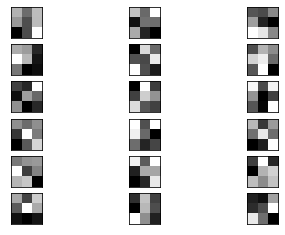

In [ ]:
import matplotlib.pyplot as plt
f_min, f_max = filters.min(), filters.max()
filters = (filters - f_min) / (f_max - f_min)
# plot first few filters
n_filters, ix = 6, 1
for i in range(n_filters):
	# get the filter
	f = filters[:, :, :, i]
	# plot each channel separately
	for j in range(3):
		# specify subplot and turn of axis
		ax = plt.subplot(n_filters, 3, ix)
		ax.set_xticks([])
		ax.set_yticks([])
		# plot filter channel in grayscale
		plt.imshow(f[:, :, j], cmap='gray')
		ix += 1
# show the figure
plt.show()

In [ ]:
for i in range(len(new_model.layers)):
	layer = new_model.layers[i]
	# check for convolutional layer
	if 'conv' not in layer.name:
		continue
	# summarize output shape
	print(i, layer.name, layer.output.shape)

0 conv2d (None, 79, 79, 64)
3 conv2d_1 (None, 24, 24, 64)
6 conv2d_2 (None, 6, 6, 128)
8 conv2d_3 (None, 4, 4, 128)


conv2d (3, 3, 128, 128)
64


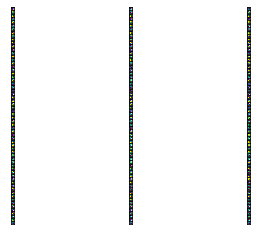

conv2d_1 (3, 3, 3, 64)
64


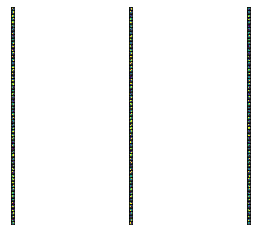

conv2d_2 (3, 3, 64, 64)
128


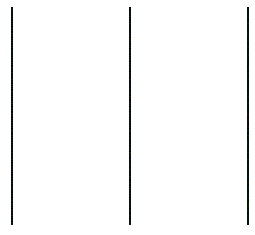

conv2d_3 (3, 3, 64, 128)
128


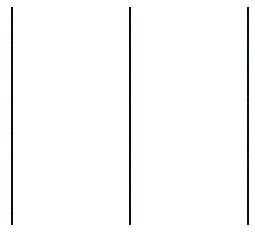

In [ ]:
model = new_model
for layer in model.layers:
    if 'conv' in layer.name:
        weights, bias= layer.get_weights()
        print(layer.name, filters.shape)
        
        #normalize filter values between  0 and 1 for visualization
        f_min, f_max = weights.min(), weights.max()
        filters = (weights - f_min) / (f_max - f_min)  
        print(filters.shape[3])
        filter_cnt=1
        
        #plotting all the filters
        for i in range(filters.shape[3]):
            #get the filters
            filt=filters[:,:,:, i]
            #plotting each of the channel, color image RGB channels
            for j in range(filters.shape[0]):
                ax= plt.subplot(filters.shape[3], filters.shape[0], filter_cnt  )
                ax.set_xticks([])
                ax.set_yticks([])
                plt.imshow(filt[:,:, j])
                filter_cnt+=1
        plt.show()

(1, 79, 79, 64)
(1, 26, 26, 64)
(1, 24, 24, 64)
(1, 24, 24, 64)
(1, 8, 8, 64)
(1, 6, 6, 128)
(1, 6, 6, 128)
(1, 4, 4, 128)
(1, 4, 4, 128)
(1, 2048)
(1, 128)
(1, 128)
(1, 128)
(1, 1)
(1, 1)


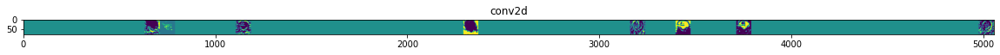

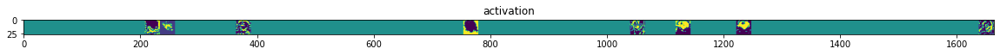

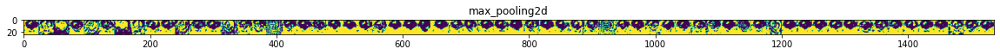

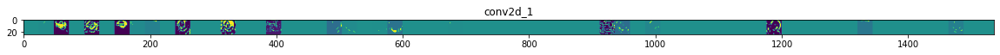

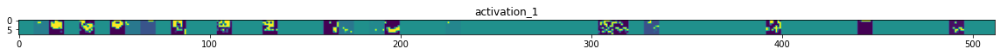

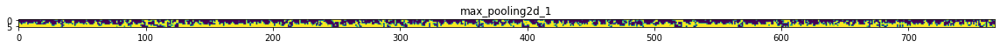

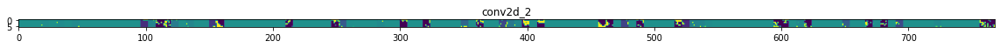

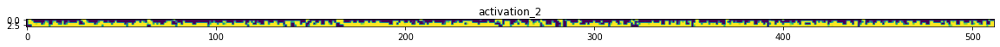

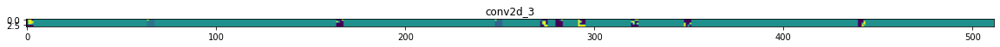

In [ ]:
import numpy as np
# Define a new Model, Input= image 
# Output= intermediate representations for all layers in the  
# previous model after the first.
successive_outputs = [layer.output for layer in model.layers[1:]]
#visualization_model = Model(img_input, successive_outputs)
visualization_model = tf.keras.models.Model(inputs = model.input, outputs = successive_outputs)
#Load the input image
#img = load_img(img_path, target_size=(150, 150))

# Convert ht image to Array of dimension (150,150,3)
#x   = img_to_array(img)       
x = X_train[5]                    
x   = x.reshape((1,) + x.shape)
# Rescale by 1/255
#x /= 255.0
# Let's run input image through our vislauization network
# to obtain all intermediate representations for the image.
successive_feature_maps = visualization_model.predict(x)
# Retrieve are the names of the layers, so can have them as part of our plot
layer_names = [layer.name for layer in model.layers]
for layer_name, feature_map in zip(layer_names, successive_feature_maps):
  print(feature_map.shape)
  if len(feature_map.shape) == 4:
    
    # Plot Feature maps for the conv / maxpool layers, not the fully-connected layers
   
    n_features = feature_map.shape[-1]  # number of features in the feature map
    size       = feature_map.shape[ 1]  # feature map shape (1, size, size, n_features)
    
    # We will tile our images in this matrix
    display_grid = np.zeros((size, size * n_features))
    
    # Postprocess the feature to be visually palatable
    for i in range(n_features):
      x  = feature_map[0, :, :, i]
      x -= x.mean()
      #x /= x.std ()
      x *=  64
      x += 128
      x  = np.clip(x, 0, 255).astype('uint8')
      # Tile each filter into a horizontal grid
      display_grid[:, i * size : (i + 1) * size] = x
# Display the grid
    scale = 20. / n_features
    plt.figure( figsize=(scale * n_features, scale) )
    plt.title ( layer_name )
    plt.grid  ( False )
    plt.imshow( display_grid, aspect='auto', cmap='viridis' )

In [ ]:
p = new_model.predict(X_test)
print(p.shape)
no_classes = new_model.predict_classes(X_test, verbose=0)
print(no_classes)

(11462, 1)


/usr/local/lib/python3.7/dist-packages/tensorflow/python/keras/engine/sequential.py:455: UserWarning: `model.predict_classes()` is deprecated and will be removed after 2021-01-01. Please use instead:* `np.argmax(model.predict(x), axis=-1)`,   if your model does multi-class classification   (e.g. if it uses a `softmax` last-layer activation).* `(model.predict(x) > 0.5).astype("int32")`,   if your model does binary classification   (e.g. if it uses a `sigmoid` last-layer activation).
  warnings.warn('`model.predict_classes()` is deprecated and '


[[1]
 [0]
 [0]
 ...
 [0]
 [0]
 [0]]


In [ ]:
from sklearn.metrics import precision_score
from sklearn.metrics import recall_score
predicted = new_model.predict(X_test)
no_classes = new_model.predict_classes(X_test, verbose=0)
predicted = predicted[:,0]
no_classes = no_classes[:,0]
precision = precision_score(Y_test, no_classes)
recall = recall_score(Y_test, no_classes)


print('Precision: %f' % precision) #High Precision means low false positivity rate
print('Recall: %f' % recall) #High recall means low false negative rate



/usr/local/lib/python3.7/dist-packages/tensorflow/python/keras/engine/sequential.py:455: UserWarning: `model.predict_classes()` is deprecated and will be removed after 2021-01-01. Please use instead:* `np.argmax(model.predict(x), axis=-1)`,   if your model does multi-class classification   (e.g. if it uses a `softmax` last-layer activation).* `(model.predict(x) > 0.5).astype("int32")`,   if your model does binary classification   (e.g. if it uses a `sigmoid` last-layer activation).
  warnings.warn('`model.predict_classes()` is deprecated and '


Precision: 0.986805
Recall: 0.973684


Taking Full Length Image with Person present in the image

(280, 269, 3)


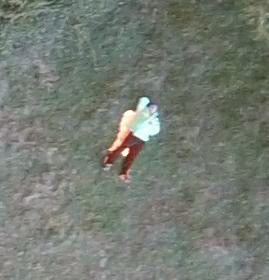

In [ ]:
from PIL import Image 

img_path = '/content/drive/MyDrive/Sem-2/CV/Project/temp1.jpg'
img = Image.open(img_path)
im1 = np.asarray(img)
print(im1.shape)
cv2_imshow(im1)
big_image = img.copy()

In [ ]:
def image_to_feature_vector(image, size=(81, 81)):
    return cv2.resize(image, size).flatten()
im1 = image_to_feature_vector(im1)
print(im1.shape)

(19683,)


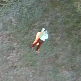

(81, 81, 3)


In [ ]:
image_1 = im1.reshape((81,81,3))
cv2_imshow(image_1)
print(image_1.shape)

In [ ]:
im1 = np.expand_dims(image_1, axis=0)
print("The prediction for this image is: ", new_model.predict(im1))

The prediction for this image is:  [[1.]]


In [ ]:
'''
#Doing it for the Validation set
Corners_Detected = []
for i in range(len(X_val)):
  img = X_val[i]
  gray = cv2.cvtColor(img, cv2.COLOR_RGB2GRAY) # convert to greyscale
  gray = np.float32(gray)
  dst = cv2.cornerHarris(gray, 2, 3, 0.04)
  dst = cv2.dilate(dst,None)
  #plt.imshow(dst, cmap='gray')
  Corners_Detected.append(dst)
'''

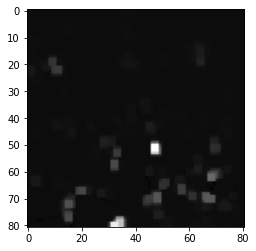

In [ ]:
'''
img = cv2.imread('/content/drive/MyDrive/Sem-2/DL/Project - Person Detection/Heridal/heridal/patches/positive/pos1.jpg')
gray = cv2.cvtColor(img, cv2.COLOR_RGB2GRAY) # convert to greyscale
gray = np.float32(gray)
dst = cv2.cornerHarris(gray, 2, 3, 0.04)
dst = cv2.dilate(dst,None)
plt.imshow(dst, cmap='gray')
'''

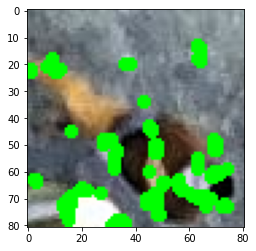

In [ ]:
'''
image_copy = np.copy(img)
thresh = 0.025*dst.max()
corner_image = np.copy(image_copy)
for j in range(0, dst.shape[0]):
    for i in range(0, dst.shape[1]):
        if(dst[j,i] > thresh):
            # image, center pt, radius, color, thickness
            cv2.circle( corner_image, (i, j), 1, (0,255,0), 1)

plt.imshow(corner_image)
'''

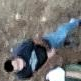

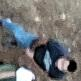

In [ ]:
'''
flipHorizontal = cv2.flip(img, 1)
cv2_imshow(flipHorizontal)
cv2_imshow(img)
'''

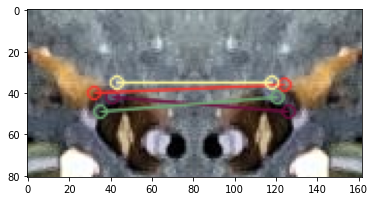

(<matplotlib.image.AxesImage at 0x7f3199ba8510>, None)

In [ ]:
'''
orb = cv2.ORB_create()
# find the keypoints and descriptors with ORB
kp1, des1 = orb.detectAndCompute(img,None)
kp2, des2 = orb.detectAndCompute(flipHorizontal,None)



bf = cv2.BFMatcher(cv2.NORM_HAMMING, crossCheck=True)
matches = bf.match(des1,des2)
matches = sorted(matches, key = lambda x:x.distance)
img3 = cv2.drawMatches(img,kp1,flipHorizontal,kp2,matches[:10],None,flags=cv2.DrawMatchesFlags_NOT_DRAW_SINGLE_POINTS)
plt.imshow(img3),plt.show()
'''

In [ ]:
'''
image_2 = cv2.imread('/content/drive/MyDrive/Sem-2/DL/Project - Person Detection/Heridal/heridal/trainImages/train_BLA_0001.JPG')
print(image_2.shape)
'''

(3000, 4000, 3)


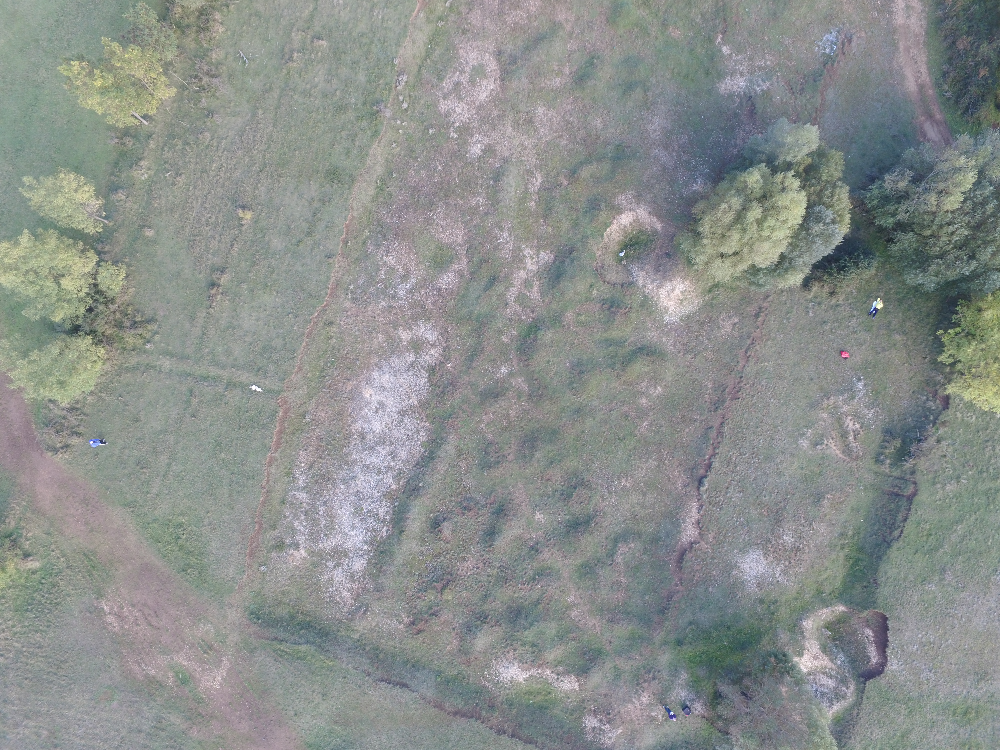

In [ ]:
#cv2_imshow(image_2)

In [ ]:
'''
def image_to_feature_vector(image, size=(81, 81)):
    return cv2.resize(image, size).flatten()
im2 = image_to_feature_vector(image_2)

im2 = im2.reshape(81,81,3)
'''

In [ ]:
#im2.shape

(81, 81, 3)

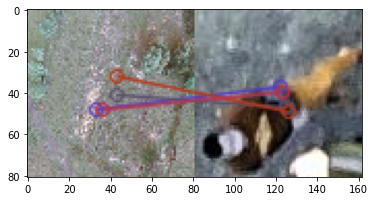

(<matplotlib.image.AxesImage at 0x7f3199b9df10>, None)

In [ ]:
'''
orb = cv2.ORB_create()
# find the keypoints and descriptors with ORB
kp1, des1 = orb.detectAndCompute(im2,None)
kp2, des2 = orb.detectAndCompute(flipHorizontal,None)



bf = cv2.BFMatcher(cv2.NORM_HAMMING, crossCheck=True)
matches = bf.match(des1,des2)
matches = sorted(matches, key = lambda x:x.distance)
img3 = cv2.drawMatches(im2,kp1,flipHorizontal,kp2,matches[:10],None,flags=cv2.DrawMatchesFlags_NOT_DRAW_SINGLE_POINTS)
plt.imshow(img3),plt.show()
'''